In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle
from library import utils, config

In [2]:
# !ls results/2-4/

In [3]:
with open('./results/7-9/traderIDs_501_1000_100_new2threshold_fixedhurst.pkl', 'rb') as f:
    traderIDs = pickle.load(f)

Importing MATLAB


In [4]:
stockPool = np.load("./results/7-9/stockPool_501_1000_100_new2threshold_fixedhurst.npy")
hurstPool = np.load("./results/7-9/hurstPool_501_1000_100_new2threshold_fixedhurst.npy")
Ttransactions = pd.read_csv("./results/7-9/transactions_501_1000_100_new2threshold_fixedhurst.csv")
TtotalOrders = pd.read_csv("./results/7-9/totalOrders_501_1000_100_new2threshold_fixedhurst.csv")

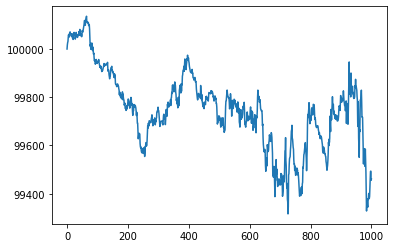

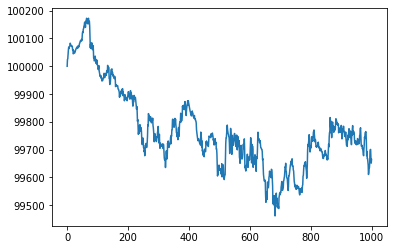

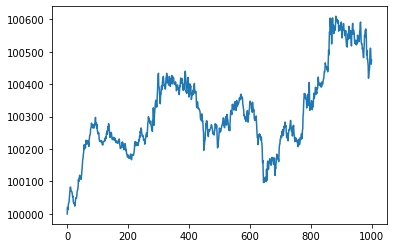

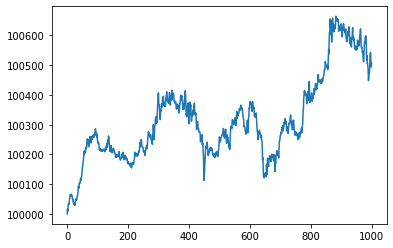

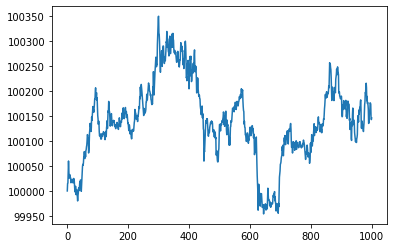

...

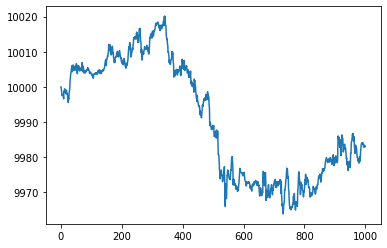

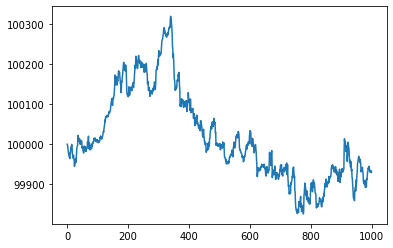

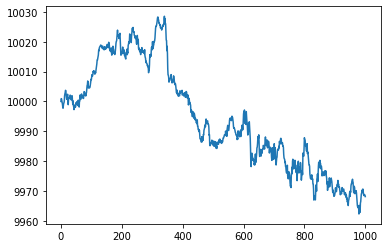

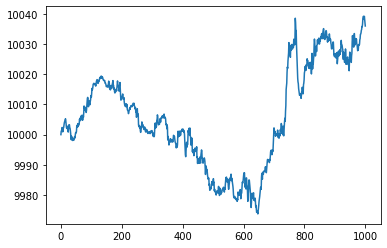

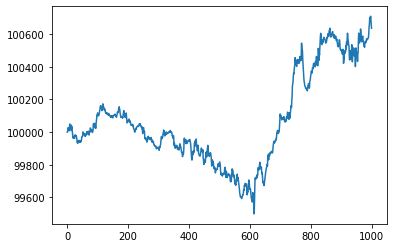

In [5]:
for portfID, portf in traderIDs.items():
# #     plt.plot(np.arange(len(portf.sharpeReal)),portf.sharpeReal, color='blue')
# #     plt.plot(np.arange(len(portf.sharpeOpt)),portf.sharpeOpt, color='red')
# #     print(len(portf.sharpeReal))
# #     plt.plot(np.arange(len(portf.sharpeReal)), portf.sharpeReal)
# #     plt.plot(np.arange(len(portf.sharpeOpt)),portf.sharpeOpt)
#     print(portfID)
    plt.plot(np.arange(len(portf.value)),portf.value)
    plt.ticklabel_format(useOffset=False)
    plt.show()

In [7]:
# TtotalOrders[:40]

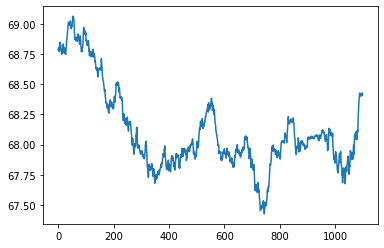

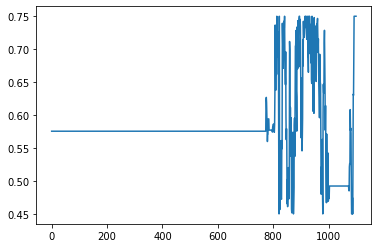

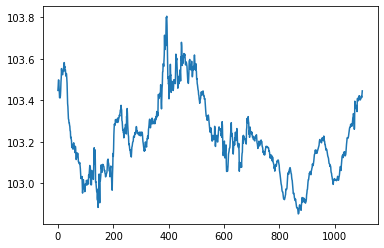

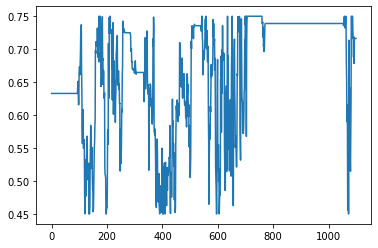

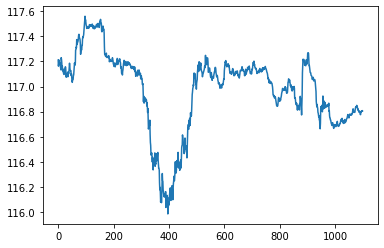

...

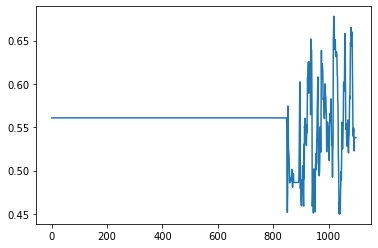

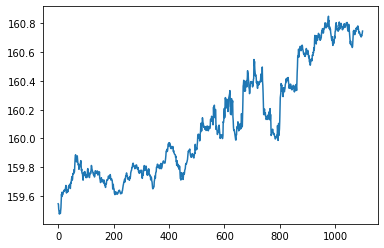

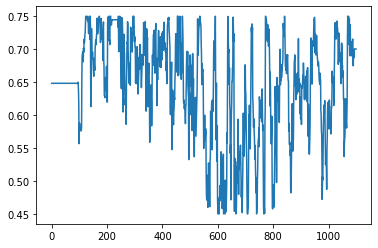

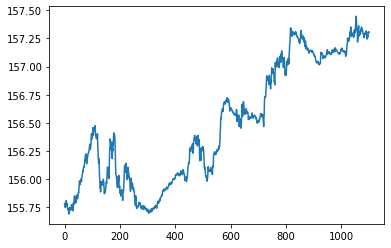

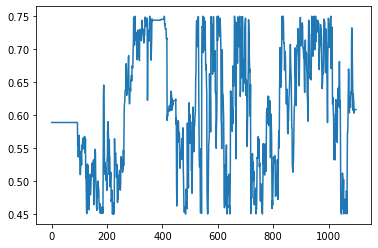

In [6]:
for i in range(100):
    plt.plot(np.arange(len(stockPool[i][900:2000])), stockPool[i][900:2000])
    plt.show()
    plt.plot(np.arange(len(hurstPool[i][900:2000])), hurstPool[i][900:2000])
    plt.show()

In [5]:
def findStockOrderCascades(stockOrders, cascade, maxSep = 2):
    """
    inpurt filtered stockOrders table with time > _time
    works on stockOrder tables, returns value of stock moved
    FOR REAL CASCADES Aug1
    """
    if len(stockOrders) > 0 :
        ToS = stockOrders['time'].unique()
        sep = np.diff(ToS)
        #print(sep)
        #print(max(sep))
        keySep = np.where(sep>maxSep)[0]
        #print(keySep)
        if len(keySep)>0:
            endtime = ToS[keySep[0]] #end of this cascade
        else:
            endtime = ToS[-1]
        cascade = pd.concat([cascade,stockOrders[stockOrders['time']<=endtime]])
        return cascade
    else:
        print() 
    
def findPortfOrderCascades(TtotalOrders, portf, t0, maxSep = 1):
    """
    input TtotalOrders, the portfolio, and minimum time
    FOR REAL CASCADES Aug18
    """

    portfOrders = TtotalOrders[TtotalOrders['portfolio']==portf]
    portfOrders = portfOrders[portfOrders['time']>=t0]
    if len(portfOrders)>0:
        ToS = portfOrders['time'].unique()
        sep = np.diff(ToS)
        #print(sep)
        #print(max(sep))
        keySep = np.where(sep>maxSep)[0]
        #print(keySep)
        if len(keySep)>0:
            endtime = ToS[keySep[0]] #end of this cascade
        else:
            endtime = ToS[-1]
        portfCascade = portfOrders[portfOrders['time']<=endtime]
        return portfCascade
    else:
        return pd.DataFrame()
    
    

# New method remove rows

In [8]:
# 1. start with 1 portfolio's set of stocks 
# 2. look at all portoflios that also hold those stocks
# 3. add their cascades to the cascade and repeat
# 4. new seed portfolio would be trades of stocks that are not within the other cascades stock pool
# TtotalOrders = pd.read_csv("./results/7-9/totalOrders_501_1000_100_new2threshold_fixedhurst.csv")

cascades = {}
numCascade = 0
cascadeStocks = {}
cascadePortfs = {}
cascadeTime = {}
cascadeTf = {}
cascades = {}
while len(TtotalOrders) > 0:
#     totalTimeOrders = TtotalOrders[TtotalOrders['time']==t]
    # seed with first portfolio
    print("OG Orders left: ", len(TtotalOrders))
    seed = (TtotalOrders.iloc[0]['portfolio'])
    t0 = TtotalOrders.iloc[0]['time']
    seedCascade = findPortfOrderCascades(TtotalOrders, seed, t0, maxSep = 1)
    cascadeStocks[numCascade] = np.asarray(seedCascade['stock'])
    cascadePortfs[numCascade] = np.asarray(seed)
    cascadeTime[numCascade] = t0
    cascades[numCascade] = seedCascade
    assert len(seedCascade) > 0
    TtotalOrders = TtotalOrders[~TtotalOrders.isin(seedCascade)].dropna()
    # NEW VERSION (PORTFOLIO PERSPECTIVE)
    for childPortf in list(TtotalOrders['portfolio'].unique()):
        if any(np.isin(cascadeStocks[numCascade],traderIDs[childPortf].stocks)):
#             print("match: ", childPortf)
            if childPortf not in cascadePortfs[numCascade]:
                cascadePortfs[numCascade] = np.append(cascadePortfs[numCascade], childPortf)
                childPortfCascade = findPortfOrderCascades(TtotalOrders,childPortf,t0, maxSep = 1)
                cascades[numCascade] = pd.concat([cascades[numCascade],childPortfCascade])
                TtotalOrders = TtotalOrders[~TtotalOrders.isin(childPortfCascade)].dropna()
                for childStock in list(childPortfCascade['stock'].unique()):
                    if childStock not in cascadeStocks[numCascade]:
                        cascadeStocks[numCascade] = np.append(cascadeStocks[numCascade], childStock)
    print("Cascade length: ",len(cascades[numCascade]))
    print("New Orders left: ", len(TtotalOrders))
    cascadeTf[numCascade] = cascades[numCascade]['time'].max()
    print("making new cascade")
    numCascade += 1
    


    
print(cascadeStocks)
print(cascadePortfs)
print(cascadeTime)

OG Orders left:  1177085
Cascade length:  6439
New Orders left:  1170646
making new cascade
OG Orders left:  1170646
Cascade length:  6828
New Orders left:  1163818
making new cascade
OG Orders left:  1163818
Cascade length:  6802
New Orders left:  1157016
making new cascade
OG Orders left:  1157016
Cascade length:  6900
New Orders left:  1150116
making new cascade
OG Orders left:  1150116
Cascade length:  6674
New Orders left:  1143442
making new cascade
OG Orders left:  1143442
Cascade length:  5974
New Orders left:  1137468
making new cascade
OG Orders left:  1137468
Cascade length:  6384
New Orders left:  1131084
making new cascade
OG Orders left:  1131084
Cascade length:  5645
New Orders left:  1125439
making new cascade
OG Orders left:  1125439
Cascade length:  5976
New Orders left:  1119463
making new cascade
OG Orders left:  1119463
Cascade length:  6689
New Orders left:  1112774
making new cascade
OG Orders left:  1112774
Cascade length:  5963
New Orders left:  1106811
making 

Cascade length:  5890
New Orders left:  527666
making new cascade
OG Orders left:  527666
Cascade length:  5562
New Orders left:  522104
making new cascade
OG Orders left:  522104
Cascade length:  5268
New Orders left:  516836
making new cascade
OG Orders left:  516836
Cascade length:  5698
New Orders left:  511138
making new cascade
OG Orders left:  511138
Cascade length:  5182
New Orders left:  505956
making new cascade
OG Orders left:  505956
Cascade length:  5345
New Orders left:  500611
making new cascade
OG Orders left:  500611
Cascade length:  5807
New Orders left:  494804
making new cascade
OG Orders left:  494804
Cascade length:  5891
New Orders left:  488913
making new cascade
OG Orders left:  488913
Cascade length:  5127
New Orders left:  483786
making new cascade
OG Orders left:  483786
Cascade length:  5540
New Orders left:  478246
making new cascade
OG Orders left:  478246
Cascade length:  4896
New Orders left:  473350
making new cascade
OG Orders left:  473350
Cascade le

Cascade length:  2677
New Orders left:  175093
making new cascade
OG Orders left:  175093
Cascade length:  2623
New Orders left:  172470
making new cascade
OG Orders left:  172470
Cascade length:  2401
New Orders left:  170069
making new cascade
OG Orders left:  170069
Cascade length:  2455
New Orders left:  167614
making new cascade
OG Orders left:  167614
Cascade length:  2775
New Orders left:  164839
making new cascade
OG Orders left:  164839
Cascade length:  2480
New Orders left:  162359
making new cascade
OG Orders left:  162359
Cascade length:  2640
New Orders left:  159719
making new cascade
OG Orders left:  159719
Cascade length:  2463
New Orders left:  157256
making new cascade
OG Orders left:  157256
Cascade length:  2576
New Orders left:  154680
making new cascade
OG Orders left:  154680
Cascade length:  2511
New Orders left:  152169
making new cascade
OG Orders left:  152169
Cascade length:  2549
New Orders left:  149620
making new cascade
OG Orders left:  149620
Cascade le

Cascade length:  128
New Orders left:  15863
making new cascade
OG Orders left:  15863
Cascade length:  195
New Orders left:  15668
making new cascade
OG Orders left:  15668
Cascade length:  67
New Orders left:  15601
making new cascade
OG Orders left:  15601
Cascade length:  145
New Orders left:  15456
making new cascade
OG Orders left:  15456
Cascade length:  66
New Orders left:  15390
making new cascade
OG Orders left:  15390
Cascade length:  113
New Orders left:  15277
making new cascade
OG Orders left:  15277
Cascade length:  133
New Orders left:  15144
making new cascade
OG Orders left:  15144
Cascade length:  100
New Orders left:  15044
making new cascade
OG Orders left:  15044
Cascade length:  89
New Orders left:  14955
making new cascade
OG Orders left:  14955
Cascade length:  136
New Orders left:  14819
making new cascade
OG Orders left:  14819
Cascade length:  76
New Orders left:  14743
making new cascade
OG Orders left:  14743
Cascade length:  111
New Orders left:  14632
ma

Cascade length:  17
New Orders left:  8572
making new cascade
OG Orders left:  8572
Cascade length:  94
New Orders left:  8478
making new cascade
OG Orders left:  8478
Cascade length:  27
New Orders left:  8451
making new cascade
OG Orders left:  8451
Cascade length:  36
New Orders left:  8415
making new cascade
OG Orders left:  8415
Cascade length:  41
New Orders left:  8374
making new cascade
OG Orders left:  8374
Cascade length:  7
New Orders left:  8367
making new cascade
OG Orders left:  8367
Cascade length:  61
New Orders left:  8306
making new cascade
OG Orders left:  8306
Cascade length:  20
New Orders left:  8286
making new cascade
OG Orders left:  8286
Cascade length:  23
New Orders left:  8263
making new cascade
OG Orders left:  8263
Cascade length:  50
New Orders left:  8213
making new cascade
OG Orders left:  8213
Cascade length:  86
New Orders left:  8127
making new cascade
OG Orders left:  8127
Cascade length:  21
New Orders left:  8106
making new cascade
OG Orders left:

Cascade length:  93
New Orders left:  4822
making new cascade
OG Orders left:  4822
Cascade length:  25
New Orders left:  4797
making new cascade
OG Orders left:  4797
Cascade length:  17
New Orders left:  4780
making new cascade
OG Orders left:  4780
Cascade length:  25
New Orders left:  4755
making new cascade
OG Orders left:  4755
Cascade length:  34
New Orders left:  4721
making new cascade
OG Orders left:  4721
Cascade length:  42
New Orders left:  4679
making new cascade
OG Orders left:  4679
Cascade length:  26
New Orders left:  4653
making new cascade
OG Orders left:  4653
Cascade length:  30
New Orders left:  4623
making new cascade
OG Orders left:  4623
Cascade length:  25
New Orders left:  4598
making new cascade
OG Orders left:  4598
Cascade length:  21
New Orders left:  4577
making new cascade
OG Orders left:  4577
Cascade length:  11
New Orders left:  4566
making new cascade
OG Orders left:  4566
Cascade length:  53
New Orders left:  4513
making new cascade
OG Orders left

Cascade length:  9
New Orders left:  2400
making new cascade
OG Orders left:  2400
Cascade length:  20
New Orders left:  2380
making new cascade
OG Orders left:  2380
Cascade length:  14
New Orders left:  2366
making new cascade
OG Orders left:  2366
Cascade length:  38
New Orders left:  2328
making new cascade
OG Orders left:  2328
Cascade length:  10
New Orders left:  2318
making new cascade
OG Orders left:  2318
Cascade length:  15
New Orders left:  2303
making new cascade
OG Orders left:  2303
Cascade length:  30
New Orders left:  2273
making new cascade
OG Orders left:  2273
Cascade length:  15
New Orders left:  2258
making new cascade
OG Orders left:  2258
Cascade length:  2
New Orders left:  2256
making new cascade
OG Orders left:  2256
Cascade length:  5
New Orders left:  2251
making new cascade
OG Orders left:  2251
Cascade length:  2
New Orders left:  2249
making new cascade
OG Orders left:  2249
Cascade length:  9
New Orders left:  2240
making new cascade
OG Orders left:  22

Cascade length:  31
New Orders left:  566
making new cascade
OG Orders left:  566
Cascade length:  14
New Orders left:  552
making new cascade
OG Orders left:  552
Cascade length:  16
New Orders left:  536
making new cascade
OG Orders left:  536
Cascade length:  5
New Orders left:  531
making new cascade
OG Orders left:  531
Cascade length:  12
New Orders left:  519
making new cascade
OG Orders left:  519
Cascade length:  12
New Orders left:  507
making new cascade
OG Orders left:  507
Cascade length:  10
New Orders left:  497
making new cascade
OG Orders left:  497
Cascade length:  23
New Orders left:  474
making new cascade
OG Orders left:  474
Cascade length:  10
New Orders left:  464
making new cascade
OG Orders left:  464
Cascade length:  44
New Orders left:  420
making new cascade
OG Orders left:  420
Cascade length:  8
New Orders left:  412
making new cascade
OG Orders left:  412
Cascade length:  25
New Orders left:  387
making new cascade
OG Orders left:  387
Cascade length:  5

{0: array(['eorqn', 'mldxq', 'elcnh', 'xdlhu', 'ednzu', 'xvmbp', 'ptuya',
       'oubpv', 'frems', 'ytvdn', 'forqu', 'wsxlp', 'zbufa', 'kzwdq',
       'pswvy', 'aorxv', 'xzoqp', 'aglux', 'vigpy', 'xpgia', 'msewr',
       'wdlak', 'lgbxu', 'wienz', 'jymkq', 'lbegq', 'qjosm', 'tompd',
       'klsev', 'gojcd', 'uofla', 'whkfl', 'gczhm', 'iyvcw', 'xqdyp',
       'rqpyw', 'fhspa', 'flaud', 'mkbuq', 'unxkh', 'ofaty', 'dnoik',
       'dgjyo', 'iqcmp', 'ceydq', 'usyro', 'xjely', 'ongfi', 'sfque',
       'osugw', 'srnpd', 'zxhni', 'xguhs', 'dlvkq', 'ngcej', 'kbpuv',
       'gdxkb', 'uphbc', 'mscof', 'hymke', 'hgnys', 'zjfkm', 'lyeqk',
       'hyfgx', 'wzqro', 'vfisj', 'dizpr', 'lpouf', 'irnge', 'gndbw',
       'nlhby', 'qhzui', 'huxvt', 'zgoib', 'jikot', 'wxcge', 'uobjx',
       'flvaz', 'wkegx', 'ukfhz', 'uyoxt', 'ndgki', 'hudwo', 'xvgic',
       'wlgsn', 'dcpgs', 'vgjkz', 'ztpwn', 'npdaf', 'kaxju', 'rjdvh',
       'qxatl', 'pqbmj', 'jsdqz', 'lifuv', 'bdpgo', 'royns', 'fmxkq',
       'vbgnk', 

In [150]:
print(len(cascades), len(cascadeTime), len(cascadeTf), len(cascadeStocks), len(cascadePortfs))
print(min(cascadeTime.values()), max(cascadeTf.values()))

724 724 724 724 724
993 1992.0


In [151]:
sizes = np.array([])
nrows = np.array([])
numCascade = len(cascades)
for i in range(numCascade):
    if cascadeTime[i] > 993 and cascadeTf[i] < 1992:
        casc = cascades[i]
        size = 0
        for row in range(len(casc)):
            time = int(casc.iloc[row]['time'])
            stock = int(casc.iloc[row]['stock'])
            volume = int(casc.iloc[row]['order'])
            size += stockPool[stock][time]*abs(volume)
        sizes = np.append(sizes, size)
        nrows = np.append(nrows, len(casc))
    else:
        print('passed cascade '+ str(i) + ' of size ' + str(len(cascades[i])))
        

passed cascade 0 of size 6439
passed cascade 1 of size 6828
passed cascade 49 of size 8201
passed cascade 57 of size 7310
passed cascade 60 of size 7350
passed cascade 63 of size 6850
passed cascade 64 of size 6630
passed cascade 66 of size 7270
passed cascade 72 of size 7122
passed cascade 73 of size 6981
passed cascade 74 of size 6433
passed cascade 75 of size 7184
passed cascade 76 of size 7517
passed cascade 78 of size 6641
passed cascade 79 of size 6570
passed cascade 80 of size 7657
passed cascade 81 of size 5968
passed cascade 82 of size 6532
passed cascade 83 of size 6013
passed cascade 84 of size 5683
passed cascade 85 of size 6284
passed cascade 86 of size 7190
passed cascade 87 of size 5997
passed cascade 90 of size 5910
passed cascade 91 of size 5890
passed cascade 93 of size 5268
passed cascade 94 of size 5698
passed cascade 96 of size 5345
passed cascade 97 of size 5807
passed cascade 98 of size 5891
passed cascade 100 of size 5540
passed cascade 101 of size 4896
passed c

Text(0, 0.5, 'count')

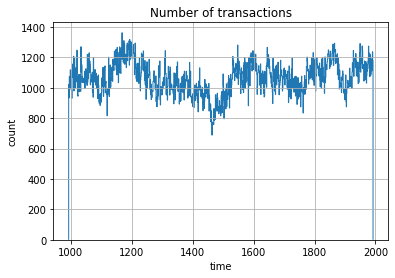

In [84]:
TtotalOrders.hist(column='time',histtype='step',bins=1000)
plt.title("Number of transactions")
plt.xlabel("time")
plt.ylabel("count")

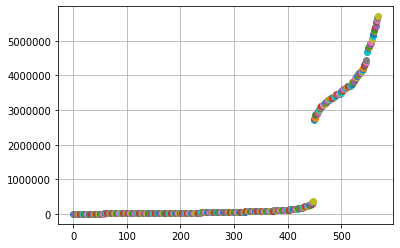

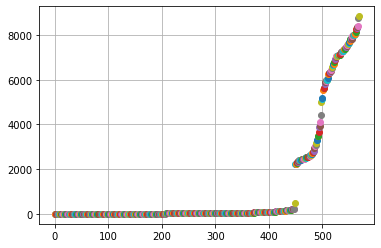

In [152]:
for i, j in enumerate(sorted(sizes)):
    plt.plot(i,j, 'o')
    plt.grid(True)
plt.show()
for i, j in enumerate(sorted(nrows)):
    plt.plot(i,j, 'o')
    plt.grid(True)
plt.show()

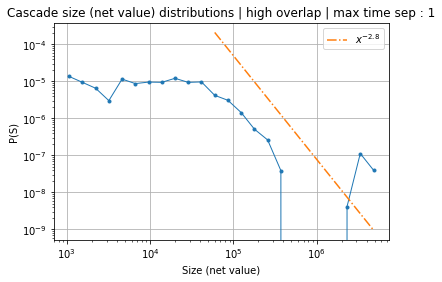

0.00011328590620696958


In [157]:
hist, bins = np.histogram(sizes, bins=np.logspace(np.log10(min(sizes)),np.log10(max(sizes)),25), density=False)
binsize = np.diff(bins)

mid = np.array([])
for i in range(len(binsize)):
    avg = (bins[i]+bins[i+1])/2
    mid = np.append(mid,avg)
    
plt.plot(mid,(hist/binsize)/len(sizes),'o-', linewidth = 1, markersize = 3)
# plt.bar(bins[:-1], hist/binsize, binsize, fill = False, linewidth = 1)
plt.plot(mid[11:],np.power(mid[11:],-2.8)*5000000000, '-.', label= "$x^{-2.8}$")
plt.loglog()
plt.legend()
plt.title("Cascade size (net value) distributions | high overlap | max time sep : 1")
plt.ylabel('P(S)')
plt.xlabel('Size (net value)')
plt.grid(True)
plt.savefig("./results/7-9/cascadesize_netvalue_79o501p1000s100t_maxsep_1.png", dpi=250)
plt.show()
plt.close()
print(np.sum((hist/binsize)/len(sizes)))

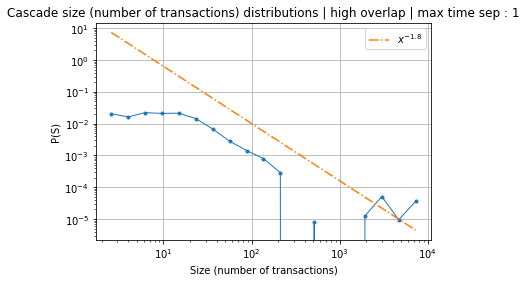

In [158]:
hist, bins = np.histogram(nrows, bins=np.logspace(np.log10(min(nrows)),np.log10(max(nrows)),20))
binsize = np.diff(bins)

mid = np.array([])
for i in range(len(binsize)):
    avg = (bins[i]+bins[i+1])/2
    mid = np.append(mid,avg)

plt.plot(mid,np.divide(hist,binsize)/len(nrows),'o-', linewidth = 1, markersize = 3)
# plt.bar(bins[:-1], hist/binsize, binsize, fill = False, linewidth = 1)
plt.plot(mid,np.power(mid,-1.8)*40, '-.', label= "$x^{-1.8}$")
plt.loglog()
plt.legend()
plt.title("Cascade size (number of transactions) distributions | high overlap | max time sep : 1")
plt.ylabel('P(S)')
plt.xlabel('Size (number of transactions)')
plt.grid(True)
plt.savefig("./results/7-9/cascadesize_ntrans_79o501p1000s100t_maxsep_1.png", dpi=250)
plt.show()
plt.close()

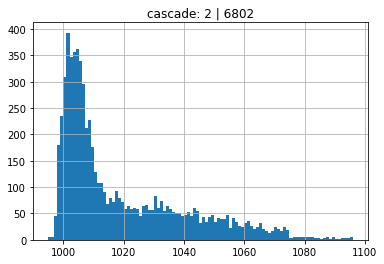

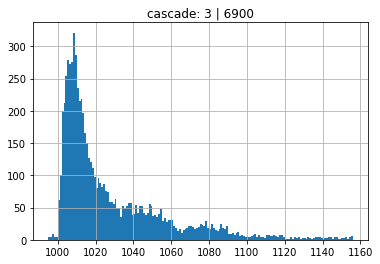

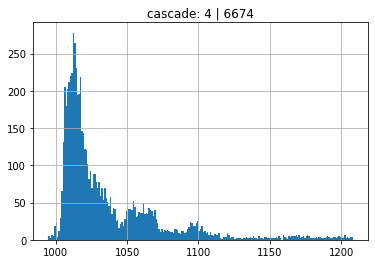

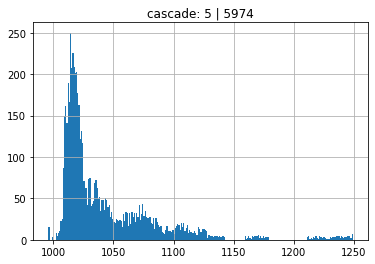

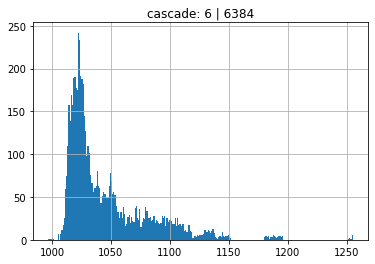

...

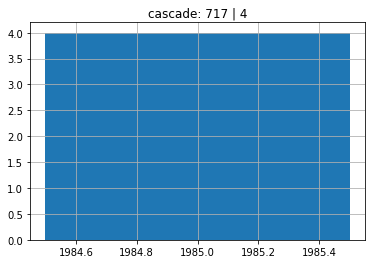

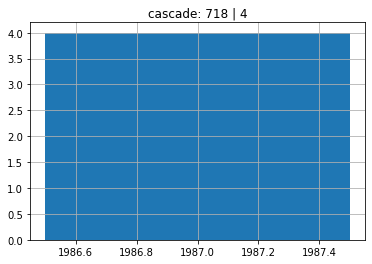

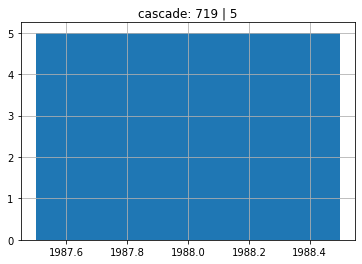

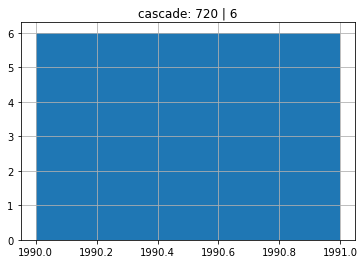

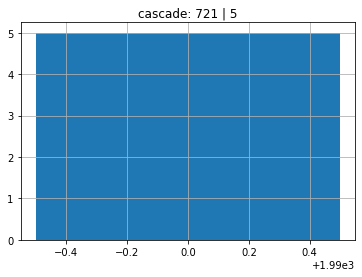

In [156]:
for i in range(len(cascades)):
    if cascadeTime[i] > 993 and cascadeTf[i] < 1992:
        if (int(cascades[i]['time'].max())-int(cascades[i]['time'].min())) > 1:
            bins = (int(cascades[i]['time'].max())-int(cascades[i]['time'].min()))
        else:
            bins = 1
        cascades[i].hist(column='time', bins = bins)
        plt.title('cascade: ' + str(i) + ' | '+ str(len(cascades[i])))
        plt.show()

In [13]:
#RUN MINSEP 2
# with open('./results/2-4/cascades_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'wb') as f:
#     pickle.dump(cascades, f, pickle.HIGHEST_PROTOCOL)
# with open('./results/2-4/cascadesTime_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'wb') as f:
#     pickle.dump(cascadeTime, f, pickle.HIGHEST_PROTOCOL)
# with open('./results/2-4/cascadeStocks_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'wb') as f:
#     pickle.dump(cascadeStocks, f, pickle.HIGHEST_PROTOCOL)
# with open('./results/2-4/cascadePortf_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'wb') as f:
#     pickle.dump(cascadePortfs, f, pickle.HIGHEST_PROTOCOL)
# with open('./results/2-4/cascadeTf_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'wb') as f:
#     pickle.dump(cascadeTf, f, pickle.HIGHEST_PROTOCOL)    
    
# with open('./results/7-9/cascades_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'rb') as f:
#     cascades = pickle.load(f)
# with open('./results/7-9/cascadesTime_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'rb') as f:
#     cascadeTime = pickle.load(f)
# with open('./results/7-9/cascadeStocks_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'rb') as f:
#     cascadeStocks = pickle.load(f)
# with open('./results/7-9/cascadePortf_minsep1_501_1000_100_new2threshold_fixedhurst.pkl', 'rb') as f:
#     cascadePortfs = pickle.load(f)

# Cascades with time limit effect

In [29]:
# 1. start with 1 portfolio's set of stocks 
# 2. look at all portoflios that also hold those stocks
# 3. add their cascades to the cascade and repeat
# 4. new seed portfolio would be trades of stocks that are not within the other cascades stock pool
TtotalOrders = pd.read_csv("./results/7-9/totalOrders_501_1000_100_new2threshold_fixedhurst.csv")

cascades = {}
numCascade = 0
cascadeStocks = {}
cascadePortfs = {}
cascadeTime = {}
cascadeTf = {}
cascades = {}
maxtimeeff = 2
while len(TtotalOrders) > 0:
#     totalTimeOrders = TtotalOrders[TtotalOrders['time']==t]
    # seed with first portfolio
    print("OG Orders left: ", len(TtotalOrders))
    seed = (TtotalOrders.iloc[0]['portfolio'])
    t0 = TtotalOrders.iloc[0]['time']
    seedCascade = findPortfOrderCascades(TtotalOrders, seed, t0, maxSep = 1)
    cascadeStocks[numCascade] = np.asarray(seedCascade['stock'])
    cascadePortfs[numCascade] = np.asarray(seed)
    cascadeTime[numCascade] = t0
    cascades[numCascade] = seedCascade
    stockTimes = {}
    for row in seedCascade.iterrows():
        stockTimes[row[1]['stock']] = row[1]['time'] + abs(row[1]['order'])*maxtimeeff
    assert len(seedCascade) > 0
    TtotalOrders = TtotalOrders[~TtotalOrders.isin(seedCascade)].dropna()
    # NEW VERSION (PORTFOLIO PERSPECTIVE)
    for childPortf in list(TtotalOrders['portfolio'].unique()):
        match = False
        if any(np.isin(cascadeStocks[numCascade],traderIDs[childPortf].stocks)):
#             print("match: ", childPortf)
            if childPortf not in cascadePortfs[numCascade]:
                childPortfCascade = findPortfOrderCascades(TtotalOrders,childPortf,t0, maxSep = 1)
                for row in childPortfCascade.iterrows():
                    if row[1]['stock'] in stockTimes:
                        if row[1]['time'] <= stockTimes[row[1]['stock']]:
                            match = True
                            break 
                if match == True:        
                    cascadePortfs[numCascade] = np.append(cascadePortfs[numCascade], childPortf)
                    cascades[numCascade] = pd.concat([cascades[numCascade],childPortfCascade])
                    TtotalOrders = TtotalOrders[~TtotalOrders.isin(childPortfCascade)].dropna()
#                     for childStock in list(childPortfCascade['stock'].unique()):
#                         if childStock not in cascadeStocks[numCascade]:
#                             cascadeStocks[numCascade] = np.append(cascadeStocks[numCascade], childStock)
                    for row in childPortfCascade.iterrows():
                        if row[1]['stock'] in stockTimes:
                            stockTimes[row[1]['stock']] += abs(row[1]['order'])*maxtimeeff
                        else:
                            stockTimes[row[1]['stock']] = row[1]['time'] + abs(row[1]['order'])*maxtimeeff
                            cascadeStocks[numCascade] = np.append(cascadeStocks[numCascade], row[1]['stock'])
    print("Cascade length: ",len(cascades[numCascade]))
    print("New Orders left: ", len(TtotalOrders))
    cascadeTf[numCascade] = cascades[numCascade]['time'].max()
    print("making new cascade")
    numCascade += 1
    


    
print(cascadeStocks)
print(cascadePortfs)
print(cascadeTime)

OG Orders left:  1177085
Cascade length:  6438
New Orders left:  1170647
making new cascade
OG Orders left:  1170647
Cascade length:  6555
New Orders left:  1164092
making new cascade
OG Orders left:  1164092
Cascade length:  6816
New Orders left:  1157276
making new cascade
OG Orders left:  1157276
Cascade length:  6878
New Orders left:  1150398
making new cascade
OG Orders left:  1150398
Cascade length:  6593
New Orders left:  1143805
making new cascade
OG Orders left:  1143805
Cascade length:  6020
New Orders left:  1137785
making new cascade
OG Orders left:  1137785
Cascade length:  6337
New Orders left:  1131448
making new cascade
OG Orders left:  1131448
Cascade length:  6
New Orders left:  1131442
making new cascade
OG Orders left:  1131442
Cascade length:  5597
New Orders left:  1125845
making new cascade
OG Orders left:  1125845
Cascade length:  6073
New Orders left:  1119772
making new cascade
OG Orders left:  1119772
Cascade length:  6714
New Orders left:  1113058
making new

Cascade length:  7108
New Orders left:  831783
making new cascade
OG Orders left:  831783
Cascade length:  2
New Orders left:  831781
making new cascade
OG Orders left:  831781
Cascade length:  10
New Orders left:  831771
making new cascade
OG Orders left:  831771
Cascade length:  10
New Orders left:  831761
making new cascade
OG Orders left:  831761
Cascade length:  12
New Orders left:  831749
making new cascade
OG Orders left:  831749
Cascade length:  7937
New Orders left:  823812
making new cascade
OG Orders left:  823812
Cascade length:  7962
New Orders left:  815850
making new cascade
OG Orders left:  815850
Cascade length:  21
New Orders left:  815829
making new cascade
OG Orders left:  815829
Cascade length:  4
New Orders left:  815825
making new cascade
OG Orders left:  815825
Cascade length:  7628
New Orders left:  808197
making new cascade
OG Orders left:  808197
Cascade length:  3
New Orders left:  808194
making new cascade
OG Orders left:  808194
Cascade length:  7845
New O

Cascade length:  4
New Orders left:  618302
making new cascade
OG Orders left:  618302
Cascade length:  4
New Orders left:  618298
making new cascade
OG Orders left:  618298
Cascade length:  6133
New Orders left:  612165
making new cascade
OG Orders left:  612165
Cascade length:  7
New Orders left:  612158
making new cascade
OG Orders left:  612158
Cascade length:  9
New Orders left:  612149
making new cascade
OG Orders left:  612149
Cascade length:  7094
New Orders left:  605055
making new cascade
OG Orders left:  605055
Cascade length:  6584
New Orders left:  598471
making new cascade
OG Orders left:  598471
Cascade length:  10
New Orders left:  598461
making new cascade
OG Orders left:  598461
Cascade length:  2
New Orders left:  598459
making new cascade
OG Orders left:  598459
Cascade length:  6519
New Orders left:  591940
making new cascade
OG Orders left:  591940
Cascade length:  4
New Orders left:  591936
making new cascade
OG Orders left:  591936
Cascade length:  6120
New Orde

Cascade length:  6
New Orders left:  449087
making new cascade
OG Orders left:  449087
Cascade length:  4
New Orders left:  449083
making new cascade
OG Orders left:  449083
Cascade length:  4557
New Orders left:  444526
making new cascade
OG Orders left:  444526
Cascade length:  3
New Orders left:  444523
making new cascade
OG Orders left:  444523
Cascade length:  4259
New Orders left:  440264
making new cascade
OG Orders left:  440264
Cascade length:  13
New Orders left:  440251
making new cascade
OG Orders left:  440251
Cascade length:  4460
New Orders left:  435791
making new cascade
OG Orders left:  435791
Cascade length:  4709
New Orders left:  431082
making new cascade
OG Orders left:  431082
Cascade length:  4
New Orders left:  431078
making new cascade
OG Orders left:  431078
Cascade length:  6
New Orders left:  431072
making new cascade
OG Orders left:  431072
Cascade length:  8
New Orders left:  431064
making new cascade
OG Orders left:  431064
Cascade length:  4176
New Orde

Cascade length:  2
New Orders left:  281138
making new cascade
OG Orders left:  281138
Cascade length:  11
New Orders left:  281127
making new cascade
OG Orders left:  281127
Cascade length:  3028
New Orders left:  278099
making new cascade
OG Orders left:  278099
Cascade length:  2813
New Orders left:  275286
making new cascade
OG Orders left:  275286
Cascade length:  11
New Orders left:  275275
making new cascade
OG Orders left:  275275
Cascade length:  3093
New Orders left:  272182
making new cascade
OG Orders left:  272182
Cascade length:  2
New Orders left:  272180
making new cascade
OG Orders left:  272180
Cascade length:  2600
New Orders left:  269580
making new cascade
OG Orders left:  269580
Cascade length:  6
New Orders left:  269574
making new cascade
OG Orders left:  269574
Cascade length:  1
New Orders left:  269573
making new cascade
OG Orders left:  269573
Cascade length:  28
New Orders left:  269545
making new cascade
OG Orders left:  269545
Cascade length:  3056
New Or

Cascade length:  2
New Orders left:  172814
making new cascade
OG Orders left:  172814
Cascade length:  2414
New Orders left:  170400
making new cascade
OG Orders left:  170400
Cascade length:  5
New Orders left:  170395
making new cascade
OG Orders left:  170395
Cascade length:  103
New Orders left:  170292
making new cascade
OG Orders left:  170292
Cascade length:  8
New Orders left:  170284
making new cascade
OG Orders left:  170284
Cascade length:  9
New Orders left:  170275
making new cascade
OG Orders left:  170275
Cascade length:  2434
New Orders left:  167841
making new cascade
OG Orders left:  167841
Cascade length:  2442
New Orders left:  165399
making new cascade
OG Orders left:  165399
Cascade length:  44
New Orders left:  165355
making new cascade
OG Orders left:  165355
Cascade length:  35
New Orders left:  165320
making new cascade
OG Orders left:  165320
Cascade length:  2323
New Orders left:  162997
making new cascade
OG Orders left:  162997
Cascade length:  29
New Ord

Cascade length:  2068
New Orders left:  97954
making new cascade
OG Orders left:  97954
Cascade length:  115
New Orders left:  97839
making new cascade
OG Orders left:  97839
Cascade length:  1892
New Orders left:  95947
making new cascade
OG Orders left:  95947
Cascade length:  2120
New Orders left:  93827
making new cascade
OG Orders left:  93827
Cascade length:  2196
New Orders left:  91631
making new cascade
OG Orders left:  91631
Cascade length:  1
New Orders left:  91630
making new cascade
OG Orders left:  91630
Cascade length:  36
New Orders left:  91594
making new cascade
OG Orders left:  91594
Cascade length:  2184
New Orders left:  89410
making new cascade
OG Orders left:  89410
Cascade length:  8
New Orders left:  89402
making new cascade
OG Orders left:  89402
Cascade length:  69
New Orders left:  89333
making new cascade
OG Orders left:  89333
Cascade length:  1997
New Orders left:  87336
making new cascade
OG Orders left:  87336
Cascade length:  21
New Orders left:  87315

Cascade length:  42
New Orders left:  40330
making new cascade
OG Orders left:  40330
Cascade length:  332
New Orders left:  39998
making new cascade
OG Orders left:  39998
Cascade length:  26
New Orders left:  39972
making new cascade
OG Orders left:  39972
Cascade length:  303
New Orders left:  39669
making new cascade
OG Orders left:  39669
Cascade length:  417
New Orders left:  39252
making new cascade
OG Orders left:  39252
Cascade length:  11
New Orders left:  39241
making new cascade
OG Orders left:  39241
Cascade length:  53
New Orders left:  39188
making new cascade
OG Orders left:  39188
Cascade length:  11
New Orders left:  39177
making new cascade
OG Orders left:  39177
Cascade length:  206
New Orders left:  38971
making new cascade
OG Orders left:  38971
Cascade length:  16
New Orders left:  38955
making new cascade
OG Orders left:  38955
Cascade length:  154
New Orders left:  38801
making new cascade
OG Orders left:  38801
Cascade length:  537
New Orders left:  38264
maki

Cascade length:  8
New Orders left:  22366
making new cascade
OG Orders left:  22366
Cascade length:  23
New Orders left:  22343
making new cascade
OG Orders left:  22343
Cascade length:  207
New Orders left:  22136
making new cascade
OG Orders left:  22136
Cascade length:  10
New Orders left:  22126
making new cascade
OG Orders left:  22126
Cascade length:  178
New Orders left:  21948
making new cascade
OG Orders left:  21948
Cascade length:  298
New Orders left:  21650
making new cascade
OG Orders left:  21650
Cascade length:  166
New Orders left:  21484
making new cascade
OG Orders left:  21484
Cascade length:  216
New Orders left:  21268
making new cascade
OG Orders left:  21268
Cascade length:  224
New Orders left:  21044
making new cascade
OG Orders left:  21044
Cascade length:  8
New Orders left:  21036
making new cascade
OG Orders left:  21036
Cascade length:  383
New Orders left:  20653
making new cascade
OG Orders left:  20653
Cascade length:  26
New Orders left:  20627
makin

Cascade length:  125
New Orders left:  11826
making new cascade
OG Orders left:  11826
Cascade length:  3
New Orders left:  11823
making new cascade
OG Orders left:  11823
Cascade length:  21
New Orders left:  11802
making new cascade
OG Orders left:  11802
Cascade length:  150
New Orders left:  11652
making new cascade
OG Orders left:  11652
Cascade length:  9
New Orders left:  11643
making new cascade
OG Orders left:  11643
Cascade length:  23
New Orders left:  11620
making new cascade
OG Orders left:  11620
Cascade length:  2
New Orders left:  11618
making new cascade
OG Orders left:  11618
Cascade length:  143
New Orders left:  11475
making new cascade
OG Orders left:  11475
Cascade length:  170
New Orders left:  11305
making new cascade
OG Orders left:  11305
Cascade length:  13
New Orders left:  11292
making new cascade
OG Orders left:  11292
Cascade length:  7
New Orders left:  11285
making new cascade
OG Orders left:  11285
Cascade length:  152
New Orders left:  11133
making ne

Cascade length:  100
New Orders left:  4810
making new cascade
OG Orders left:  4810
Cascade length:  4
New Orders left:  4806
making new cascade
OG Orders left:  4806
Cascade length:  81
New Orders left:  4725
making new cascade
OG Orders left:  4725
Cascade length:  22
New Orders left:  4703
making new cascade
OG Orders left:  4703
Cascade length:  52
New Orders left:  4651
making new cascade
OG Orders left:  4651
Cascade length:  120
New Orders left:  4531
making new cascade
OG Orders left:  4531
Cascade length:  18
New Orders left:  4513
making new cascade
OG Orders left:  4513
Cascade length:  3
New Orders left:  4510
making new cascade
OG Orders left:  4510
Cascade length:  201
New Orders left:  4309
making new cascade
OG Orders left:  4309
Cascade length:  26
New Orders left:  4283
making new cascade
OG Orders left:  4283
Cascade length:  65
New Orders left:  4218
making new cascade
OG Orders left:  4218
Cascade length:  29
New Orders left:  4189
making new cascade
OG Orders lef

Cascade length:  10
New Orders left:  744
making new cascade
OG Orders left:  744
Cascade length:  21
New Orders left:  723
making new cascade
OG Orders left:  723
Cascade length:  32
New Orders left:  691
making new cascade
OG Orders left:  691
Cascade length:  32
New Orders left:  659
making new cascade
OG Orders left:  659
Cascade length:  25
New Orders left:  634
making new cascade
OG Orders left:  634
Cascade length:  31
New Orders left:  603
making new cascade
OG Orders left:  603
Cascade length:  42
New Orders left:  561
making new cascade
OG Orders left:  561
Cascade length:  28
New Orders left:  533
making new cascade
OG Orders left:  533
Cascade length:  8
New Orders left:  525
making new cascade
OG Orders left:  525
Cascade length:  33
New Orders left:  492
making new cascade
OG Orders left:  492
Cascade length:  19
New Orders left:  473
making new cascade
OG Orders left:  473
Cascade length:  15
New Orders left:  458
making new cascade
OG Orders left:  458
Cascade length:  

{0: array(['eorqn', 'mldxq', 'elcnh', 'xdlhu', 'ednzu', 'xvmbp', 'ptuya',
       'oubpv', 'frems', 'ytvdn', 'forqu', 'wsxlp', 'zbufa', 'kzwdq',
       'pswvy', 'aorxv', 'xzoqp', 'aglux', 'xpgia', 'msewr', 'wdlak',
       'lgbxu', 'wienz', 'jymkq', 'lbegq', 'qjosm', 'tompd', 'klsev',
       'gojcd', 'uofla', 'whkfl', 'gczhm', 'iyvcw', 'xqdyp', 'rqpyw',
       'fhspa', 'flaud', 'mkbuq', 'unxkh', 'ofaty', 'dnoik', 'dgjyo',
       'iqcmp', 'ceydq', 'usyro', 'xjely', 'ongfi', 'sfque', 'osugw',
       'srnpd', 'zxhni', 'xguhs', 'dlvkq', 'ngcej', 'kbpuv', 'gdxkb',
       'uphbc', 'mscof', 'hymke', 'hgnys', 'zjfkm', 'lyeqk', 'hyfgx',
       'wzqro', 'vfisj', 'dizpr', 'lpouf', 'irnge', 'gndbw', 'nlhby',
       'qhzui', 'huxvt', 'zgoib', 'jikot', 'wxcge', 'uobjx', 'flvaz',
       'wkegx', 'ukfhz', 'uyoxt', 'ndgki', 'hudwo', 'xvgic', 'wlgsn',
       'dcpgs', 'vgjkz', 'ztpwn', 'npdaf', 'kaxju', 'rjdvh', 'qxatl',
       'pqbmj', 'jsdqz', 'lifuv', 'bdpgo', 'royns', 'fmxkq', 'vbgnk',
       'sqfhc', 

In [30]:
sizes = np.array([])
nrows = np.array([])
duration = np.array([])
numCascade = len(cascades)
for i in range(numCascade):
    if cascadeTime[i] > 993 and cascadeTf[i] < 1992:
        casc = cascades[i]
        size = 0
        for row in range(len(casc)):
            time = int(casc.iloc[row]['time'])
            stock = int(casc.iloc[row]['stock'])
            volume = int(casc.iloc[row]['order'])
            size += stockPool[stock][time]*abs(volume)
        dur = casc['time'].max()-casc['time'].min()
        if dur == 0:
            dur = 1
        duration = np.append(duration, dur)
        sizes = np.append(sizes, size)
        nrows = np.append(nrows, len(casc))
    else:
        print('passed cascade '+ str(i) + ' of size ' + str(len(cascades[i])))

passed cascade 0 of size 6438
passed cascade 1 of size 6555
passed cascade 2 of size 6816
passed cascade 97 of size 7937
passed cascade 111 of size 7084
passed cascade 139 of size 6829
passed cascade 144 of size 7355
passed cascade 160 of size 7179
passed cascade 169 of size 6491
passed cascade 170 of size 6342
passed cascade 174 of size 7053
passed cascade 175 of size 7052
passed cascade 187 of size 6133
passed cascade 190 of size 7094
passed cascade 191 of size 6584
passed cascade 194 of size 6519
passed cascade 196 of size 6120
passed cascade 197 of size 6097
passed cascade 205 of size 6061
passed cascade 206 of size 6817
passed cascade 211 of size 6293
passed cascade 213 of size 5581
passed cascade 217 of size 5988
passed cascade 219 of size 5486
passed cascade 231 of size 5429
passed cascade 241 of size 5134
passed cascade 245 of size 5799
passed cascade 246 of size 5654
passed cascade 261 of size 5386
passed cascade 262 of size 4819
passed cascade 264 of size 5585
passed cascade 

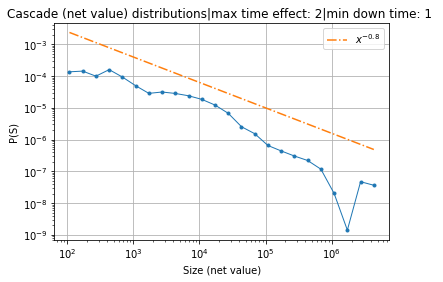

In [37]:
hist, bins = np.histogram(sizes, bins=np.logspace(np.log10(min(sizes)),np.log10(max(sizes)), 25))
binsize = np.diff(bins)

mid = np.array([])
for i in range(len(binsize)):
    avg = (bins[i]+bins[i+1])/2
    mid = np.append(mid,avg)
    
plt.plot(mid,np.divide(hist,binsize)/len(sizes),'o-', linewidth = 1, markersize = 3)
plt.plot(mid,np.power(mid,-0.8)/10, '-.', label= "$x^{-0.8}$")
plt.loglog()
plt.legend()
plt.title("Cascade (net value) distributions|max time effect: "+str(maxtimeeff)+"|min down time: 1 ")
plt.ylabel('P(S)')
plt.xlabel('Size (net value)')
plt.grid(True)
plt.savefig("./results/7-9/cascadesize2_netvalue_79o501p1000s100t_maxsep_1_volsep_"+str(maxtimeeff)+".png", dpi=250)
plt.show()
plt.close()

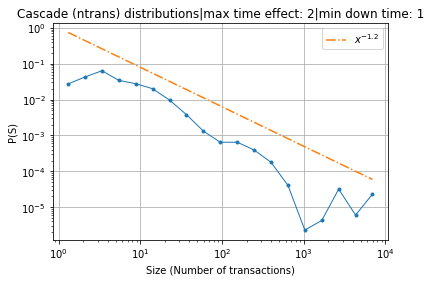

In [38]:
hist, bins = np.histogram(nrows, bins=np.logspace(np.log10(min(nrows)),np.log10(max(nrows)),20))
binsize = np.diff(bins)

mid = np.array([])
for i in range(len(binsize)):
    avg = (bins[i]+bins[i+1])/2
    mid = np.append(mid,avg)

plt.plot(mid,np.divide(hist,binsize)/len(nrows),'o-', linewidth = 1, markersize = 3)
plt.plot(mid,np.power(mid,-1.1), '-.', label= "$x^{-1.2}$")
plt.loglog()
plt.legend()
plt.title("Cascade (ntrans) distributions|max time effect: "+str(maxtimeeff)+"|min down time: 1")
plt.ylabel('P(S)')
plt.xlabel('Size (Number of transactions)')
plt.grid(True)
plt.savefig("./results/7-9/cascadesize2_ntrans_79o501p1000s100t_maxsep_1_volsep_"+str(maxtimeeff)+".png", dpi=250)
plt.show()
plt.close()

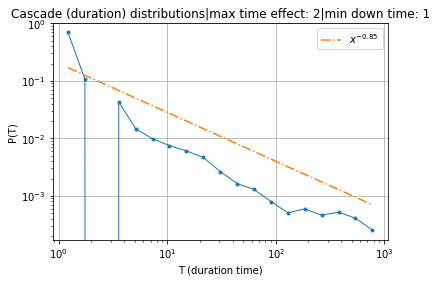

In [41]:
hist, bins = np.histogram(duration, bins=np.logspace(np.log10(min(duration)),np.log10(max(duration)),20))
binsize = np.diff(bins)

mid = np.array([])
for i in range(len(binsize)):
    avg = (bins[i]+bins[i+1])/2
    mid = np.append(mid,avg)

plt.plot(mid,np.divide(hist,binsize)/len(nrows),'o-', linewidth = 1, markersize = 3)
plt.plot(mid,np.power(mid,-0.85)/5, '-.', label= "$x^{-0.85}$")
plt.loglog()
plt.legend()
plt.title("Cascade (duration) distributions|max time effect: "+str(maxtimeeff)+"|min down time: 1")
plt.ylabel('P(T)')
plt.xlabel('T (duration time)')
plt.grid(True)
plt.savefig("./results/7-9/cascadesize2_duration_79o501p1000s100t_maxsep_1_volsep_"+str(maxtimeeff)+".png", dpi=250)
plt.show()
plt.close()

In [34]:
with open('./results/7-9/cascades2_79o501p1000s100t_minsep_1_volsep_'+str(maxtimeeff)+'.pkl', 'wb') as f:
    pickle.dump(cascades, f, pickle.HIGHEST_PROTOCOL)
with open('./results/7-9/cascadesTime2_79o501p1000s100t_minsep_1_volsep_'+str(maxtimeeff)+'.pkl', 'wb') as f:
    pickle.dump(cascadeTime, f, pickle.HIGHEST_PROTOCOL)
with open('./results/7-9/cascadeStocks2_79o501p1000s100t_minsep_1_volsep_'+str(maxtimeeff)+'.pkl', 'wb') as f:
    pickle.dump(cascadeStocks, f, pickle.HIGHEST_PROTOCOL)
with open('./results/7-9/cascadePortf2_79o501p1000s100t_minsep_1_volsep_'+str(maxtimeeff)+'.pkl', 'wb') as f:
    pickle.dump(cascadePortfs, f, pickle.HIGHEST_PROTOCOL)
with open('./results/7-9/cascadeTf2_79o501p1000s100t_minsep_1_volsep_'+str(maxtimeeff)+'pkl', 'wb') as f:
    pickle.dump(cascadeTf, f, pickle.HIGHEST_PROTOCOL) 

In [169]:
from scipy import stats

def overlapPortfs(portf1, portf2):
    overlap = 0
    for i in portf1.stocks:
        for j in portf2.stocks:
            if i == j:
                overlap +=1
    return overlap

In [183]:
mat = np.zeros((501,501))
x = 0
y = 0
for i, portf1 in traderIDs.items():
    y=0
    for j, portf2 in traderIDs.items():
        if i == j:
            overlap = 0
        else:
            overlap = overlapPortfs(portf1,portf2)
        mat[x,y] = overlap
        y += 1
    x += 1

In [194]:
for i in range(50,500,10):
    print(max(mat[i]))

8.0
8.0
7.0
7.0
8.0
8.0
8.0
5.0
8.0
8.0
7.0
4.0
7.0
7.0
7.0
8.0
8.0
8.0
8.0
4.0
8.0
8.0
8.0
8.0
8.0
7.0
8.0
8.0
7.0
8.0
8.0
8.0
8.0
7.0
8.0
8.0
8.0
8.0
7.0
5.0
8.0
8.0
8.0
8.0
8.0


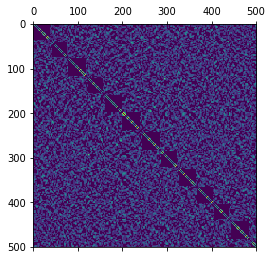

0.9813666081011629 8.0 0.0 1.0 ModeResult(mode=array([1.]), count=array([95140]))


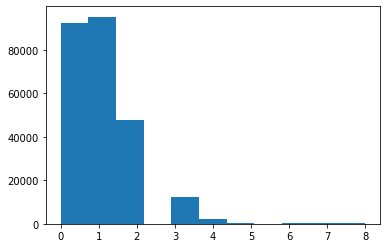

In [185]:
plt.matshow(mat)
plt.show()
print(np.average(mat), np.max(mat), np.min(mat), np.median(mat), stats.mode(mat, axis=None))
plt.hist(mat.flatten(), bins = 11)
plt.show()

In [73]:
# cascadeTf = {}
# for numCascade in range(len(cascades)):
#     cascadeTf[numCascade] = cascades[numCascade]['time'].max()

# for i in range(1,len(cascades)):
#     overlap = 0
#     for portf0 in cascadePortfs[0]:
#         for portf1 in cascadePortfs[i]:
#             if portf0 == portf1:
#                 overlap +=1
#                 break
#     if cascadeTime[i]<cascadeTf[0]:
#         print("Cascade ", i, 'overlap: ', overlap, '/', len(cascadePortfs[i]), ' Same Time')
#     else:
#         print("Cascade ", i, 'overlap: ', overlap, '/', len(cascadePortfs[i]))

In [ ]:
def weightSharpeMovie(portf,TstockChars,TstockPool):
    """
    update to show +/- returns and color code each stock and average over time
    """
#     ovar = np.array([])
#     oalloc = np.array([])
#     omean = np.array([])
    ocashalloc = 0
    times = portf.valuedata.time.unique()
    stocks = portf.stocks
    ovar = np.zeros(len(stocks))
    oalloc = np.zeros(len(stocks))
    omean = np.zeros(len(stocks))
    ostd = np.zeros(len(stocks))
    
    for t in times[1::10]:
        alloc = np.array([])
        var = np.array([])
        mean = np.array([])
        std = np.array([])
        maxvar = max(TstockChars[TstockChars.stock.isin(stocks)]['var'])+0.5
        maxalloc = 1
        
        
        for s in stocks:
            weight = portf.weightdata[portf.weightdata.time==t]
            alloc = np.append(alloc, weight[weight.stock==s].weight[0]*TstockPool[s,t]/
                                 portf.valuedata[portf.valuedata.time==t].value[0])
            timeStockChars = TstockChars[TstockChars.time==t]
            var = np.append(var,timeStockChars[timeStockChars['stock']==s]['var'])
            mean = np.append(mean,timeStockChars[timeStockChars['stock']==s]['mean'])
            std = np.append(std,timeStockChars[timeStockChars['stock']==s]['std'])
            
        # include cash
        cashalloc = portf.valuedata[portf.valuedata.time==t].cash[0]/portf.valuedata[portf.valuedata.time==t].value[0]
        cashvar = 0

        plt.plot(cashvar, ocashalloc, 'o', color='lightgreen')
        plt.plot(cashvar, cashalloc, 'o', color='green', label='Cash')
        for i , s in enumerate(stocks):
#             plt.plot(omean[i]/ostd[i],oalloc[i],'o', color = 'lightgrey')
            plt.plot(mean[i]/std[i],alloc[i], 'o', label=s)
        plt.grid(True)
    #     plt.xlim(right=maxvar, left=0)
    #     plt.ylim(top=maxalloc,bottom=0)
        plt.xlabel("Stock Mean Return/Std")
        plt.ylabel("Weight Allocation")
        plt.legend()
        plt.title("Portf ID: " + str(portf.portfID) +" | Time: "+ str(t))
        plt.savefig("./results/7-9/"+str(t).zfill(6)+'_meanstd_tmp.png',dpi=250)
#         plt.show()
        plt.close()
        ovar = var
        ostd = std
        omean = mean
        oalloc = alloc 
        ocashalloc = cashalloc
    print("Done")
    print("mencoder 'mf://*meanstd_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightsharpe_"+portf.portfID+"_new2threshold_fixedhurst.mpg")
        
def weightVarMovie(portf,TstockChars,TstockPool):
    """
    aug 21 update to show +/- returns and color code each stock and average over time
    """
    ovar = np.array([])
    oalloc = np.array([])
    ocashalloc = 0
    times = portf.valuedata.time.unique()
    
    for t in times[1::10]:
        alloc = np.array([])
        var = np.array([])
        mean = np.array([])
        stocks = portf.stocks
        maxvar = max(TstockChars[TstockChars.stock.isin(stocks)]['var'])+0.5
        maxalloc = 1
        
        
        for s in stocks:
            weight = portf.weightdata[portf.weightdata.time==t]
            alloc = np.append(alloc, weight[weight.stock==s].weight[0]*TstockPool[s,t]/
                                 portf.valuedata[portf.valuedata.time==t].value[0])
            timeStockChars = TstockChars[TstockChars.time==t]
            var = np.append(var,timeStockChars[timeStockChars.stock==s]['var'])
            mean = np.append(mean,timeStockChars[timeStockChars['stock']==s]['mean'])
            
        # include cash
        cashalloc = portf.valuedata[portf.valuedata.time==t].cash[0]/portf.valuedata[portf.valuedata.time==t].value[0]
        cashvar = 0
        
        plt.plot(cashvar, ocashalloc, 'o', color='lightgreen')
        plt.plot(cashvar, cashalloc, 'o', color='green', label='Cash')
        for i , s in enumerate(stocks):
            if alloc[i] > 0:
                plt.plot(var[i],alloc[i], 'o', label=s)
            
        plt.grid(True)
    #     plt.xlim(right=maxvar, left=0)
    #     plt.ylim(top=maxalloc,bottom=0)
        plt.xlabel("Stock Variance")
        plt.ylabel("Weight Allocation")
        plt.legend()
        plt.title("Portf ID: " + str(portf.portfID) +" | Time: "+ str(t))
        plt.savefig("./results/7-9/"+str(t).zfill(6)+'_var_tmp.png',dpi=250)
        plt.show()
        ovar = var
        oalloc = alloc 
        ocashalloc = cashalloc
    print("Done")
    print("mencoder 'mf://*var_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightvar_"+portf.portfID+"_new2threshold_fixedhurst.mpg")



In [40]:
# stockChars = utils.characterize(stockPool, tmax=2000)
stockChars

,time,stock,mean,var,std
0,992,0,-0.001781,0.001585,0.039810
0,992,1,0.000798,0.000349,0.018675
0,992,2,0.002830,0.000654,0.025574
0,992,3,-0.000075,0.000970,0.031150
0,992,4,0.000230,0.000354,0.018806
...,...,...,...,...,...
0,1999,95,-0.003361,0.003764,0.061353
0,1999,96,0.000045,0.000016,0.003939
0,1999,97,0.000783,0.000282,0.016797
0,1999,98,-0.000046,0.000003,0.001822


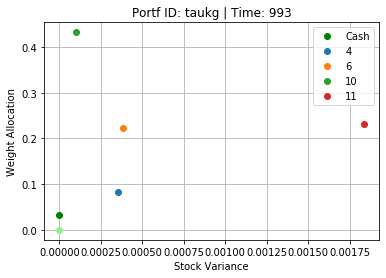

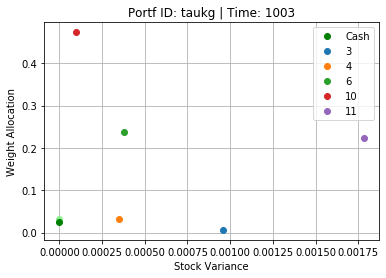

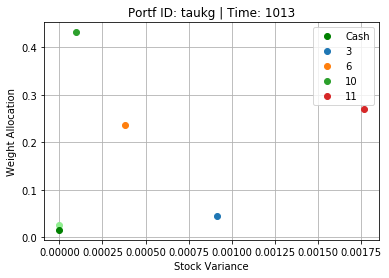

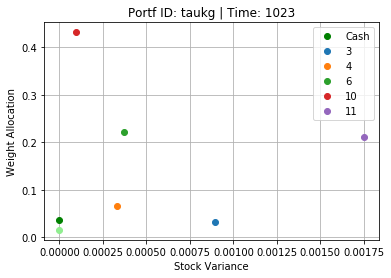

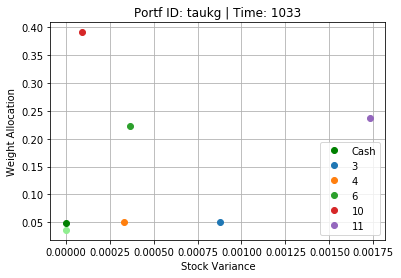

...

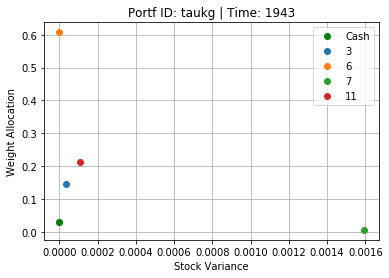

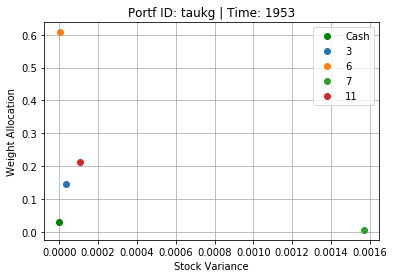

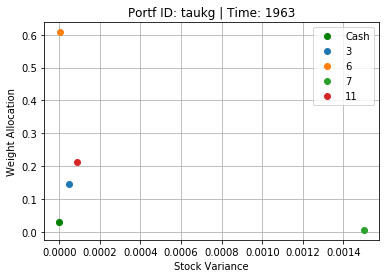

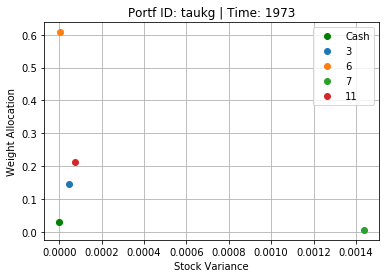

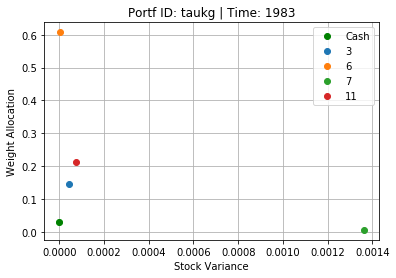

Done
mencoder 'mf://*var_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightvar_taukg_new2threshold_fixedhurst.mpg


In [63]:
weightVarMovie(traderIDs['taukg'],stockChars,stockPool)

In [ ]:
def weightSharpeAvg(portf,TstockChars,TstockPool):
    """
    """
#     ovar = np.array([])
#     oalloc = np.array([])
#     omean = np.array([])
    tmax = portf.valuedata.time.max()
    tmin = portf.valuedata.time.max()
    stocks = portf.stocks
                
    for s in stocks:
        weight = portf.weightdata[portf.weightdata.time==t]
        alloc = np.append(alloc, weight[weight.stock==s].weight[0]*TstockPool[s,t]/
                             portf.valuedata[portf.valuedata.time==t].value[0])
        timeStockChars = TstockChars[TstockChars.time==t]
        var = np.append(var,timeStockChars[timeStockChars['stock']==s]['var'])
        mean = np.append(mean,timeStockChars[timeStockChars['stock']==s]['mean'])
        std = np.append(std,timeStockChars[timeStockChars['stock']==s]['std'])

    # include cash
    cashalloc = portf.valuedata[portf.valuedata.time==t].cash[0]/portf.valuedata[portf.valuedata.time==t].value[0]
    cashvar = 0

    plt.plot(cashvar, ocashalloc, 'o', color='lightgreen')
    plt.plot(cashvar, cashalloc, 'o', color='green', label='Cash')
    for i , s in enumerate(stocks):
#             plt.plot(omean[i]/ostd[i],oalloc[i],'o', color = 'lightgrey')
        plt.plot(mean[i]/std[i],alloc[i], 'o', label=s)
    plt.grid(True)
#     plt.xlim(right=maxvar, left=0)
#     plt.ylim(top=maxalloc,bottom=0)
    plt.xlabel("Stock Mean Return/Std")
    plt.ylabel("Weight Allocation")
    plt.legend()
    plt.title("Portf ID: " + str(portf.portfID) +" | Time: "+ str(t))
    plt.savefig("./results/7-9/"+str(t).zfill(6)+'_meanstd_tmp.png',dpi=250)
#         plt.show()
    plt.close()
    ovar = var
    ostd = std
    omean = mean
    oalloc = alloc 
    ocashalloc = cashalloc

# Cascades

In [41]:
# Get stock overlap
holders = {}
for i in range(len(stockPool)):
    hold = []
    for name, portf in traderIDs.items():
        if i in portf.stocks:
            hold.append(name)
    holders[i] = hold

In [96]:
# 1. start with 1 portfolio's set of stocks 
# 2. look at all portoflios that also hold those stocks
# 3. add their cascades to the cascade and repeat
# 4. new seed portfolio would be trades of stocks that are not within the other cascades stock pool

cascades = {}
numCascade = 1
cascadeStocks = {}
cascadePortfs = {}
cascadeTime = {}
cascadeTf = {}
cascades = {}
for t in range(1000,1001):
    totalTimeOrders = TtotalOrders[TtotalOrders['time']==t]
    # seed with first portfolio
    seed = (totalTimeOrders.iloc[0]['portfolio'])
    cascadeStocks[0] = np.asarray(totalTimeOrders[totalTimeOrders['portfolio']==seed]['stock'])
    cascadePortfs[0] = np.asarray(seed)
    cascadeTime[0] = t
    cascadeStocks[numCascade] = np.array([])
    cascadePortfs[numCascade] = np.array([])
    unassigned = pd.DataFrame()
#     for row in range(len(totalTimeOrders)):
# #         print(totalTimeOrders.iloc[row]['portfolio'],totalTimeOrders.iloc[row]['stock'])
#         childPortf = totalTimeOrders.iloc[row]['portfolio']
#         childStock = totalTimeOrders.iloc[row]['stock']
#         assigned = False
#         for nCasc in range(numCascade):
            # ORIGINAL VERSION (STOCK PERSPECTIVE)
#             for stock in np.copy(cascadeStocks[nCasc]):
#                 if np.isin(childPortf,holders[stock]): # SEE IF THE STOCKS IN CHILDPORTF HAVE BEEN TRADED see if its in the seed casacde 
#                     assigned = True
# #                     print(childStock, "assigned | ", childPortf)
#                     if childStock not in cascadeStocks[nCasc]:
#                         cascadeStocks[nCasc] = np.append(cascadeStocks[nCasc], childStock)
#                         print(cascadeStocks)
#                     if childPortf not in cascadePortfs[nCasc]:
#                         cascadePortfs[nCasc] = np.append(cascadePortfs[nCasc], childPortf)
#                     break

            # NEW VERSION (PORTFOLIO PERSPECTIVE)
    for nCasc in range(numCascade):
        for childPortf in list(totalTimeOrders['portfolio'].unique()):
#             print(childPortf)
            if any(np.isin(cascadeStocks[nCasc],traderIDs[childPortf].stocks)):
                assigned = True
                for childStock in list(totalTimeOrders[totalTimeOrders['portfolio']==childPortf]['stock']):
                    if childStock not in cascadeStocks[nCasc]:
                        cascadeStocks[nCasc] = np.append(cascadeStocks[nCasc], childStock)

                if childPortf not in cascadePortfs[nCasc]:
                    cascadePortfs[nCasc] = np.append(cascadePortfs[nCasc], childPortf)
                
                    
        if assigned == False:
            print(traderIDs[childPortf].stocks, "not assigned | ", childPortf)
            unassigned = pd.concat([unassigned, totalTimeOrders[totalTimeOrders['portfolio']==childPortf]], axis=1, sort =True)
    
    unassigned = unassigned.transpose()
    print(cascadeStocks)
    # BEGIN NEW CASCADES seed with a single stock this time
    print(len(unassigned))
    while len(unassigned)>0:
        print("NUMCASC: ", numCascade)
        unassigned.reset_index(inplace=True)
        seedPortf = unassigned.iloc[0]['portfolio']
        print(seedPortf)
        cascadePortfs[numCascade] = np.append(cascadeStocks[numCascade], seedPortf)
        cascadeStocks[numCascade] = np.asarray(unassigned[unassigned['portfolio']==seedPortf]['stock'])
        cascadeTime[numCascade] = t
        print("unassigned: ", unassigned)
        toDrop = []
        for row in range(len(unassigned)):
    #         print(totalTimeOrders.iloc[row]['portfolio'],totalTimeOrders.iloc[row]['stock'])
            childPortf = unassigned.iloc[row]['portfolio']
            childStock = unassigned.iloc[row]['stock']
            assigned = False
            for nCasc in range(numCascade,numCascade+1):
                for stock in np.copy(cascadeStocks[nCasc]): 
                    if np.isin(childPortf,holders[stock]): # see if its in the seed casacde
                        toDrop.append(row)
                        if childStock not in cascadeStocks[nCasc]:
                            cascadeStocks[nCasc] = np.append(cascadeStocks[nCasc], childStock)
                        if childPortf not in cascadePortfs[nCasc]:
                            cascadePortfs[nCasc] = np.append(cascadePortfs[nCasc], childPortf)
                        break
        print("todrop: ", toDrop)
        unassigned.drop(toDrop, inplace=True)
        print("making new cascade")
        numCascade += 1
        cascadeStocks[numCascade] = np.array([])
        cascadePortfs[numCascade] = np.array([])
#     # copy orders dataframe     
#     for n, stocks in cascadeStocks.items():
#         if len(stocks) > 0:
#             totalCascade = pd.DataFrame()
#             for stock in stocks:
#                 stockOrders = TtotalOrders[TtotalOrders['time']>t]
#                 stockOrders = stockOrders[stockOrders['stock']==stock]
# #                 print("stockOrders: ",len(stockOrders))
#                 totalCascade = findStockOrderCascades(stockOrders, totalCascade, maxSep = 5)
#             cascades[n] = totalCascade
# #             print("totalCascade: ", len(totalCascade))
# #             print(totalCascade['time'].max())
#             cascadeTf[n] = totalCascade['time'].max()
# # at next time steps compare with existing seeds 

    
print(cascadeStocks)
print(cascadePortfs)
print(unassigned)
print(cascadeTime)

{0: array([ 2,  3,  4,  6,  1, 10, 11, 13, 14, 15, 73, 35, 33, 88, 83, 77, 92,
       94, 72, 99, 19, 60, 24, 32, 45, 74, 43, 78, 86, 18, 55, 59, 56, 36,
       53, 51, 50, 30, 89, 75, 40, 90, 20, 68, 41, 62, 66, 91, 31, 57, 95,
       85, 54, 28, 98]), 1: array([], dtype=float64)}
0
{0: array([ 2,  3,  4,  6,  1, 10, 11, 13, 14, 15, 73, 35, 33, 88, 83, 77, 92,
       94, 72, 99, 19, 60, 24, 32, 45, 74, 43, 78, 86, 18, 55, 59, 56, 36,
       53, 51, 50, 30, 89, 75, 40, 90, 20, 68, 41, 62, 66, 91, 31, 57, 95,
       85, 54, 28, 98]), 1: array([], dtype=float64)}
{0: array(['brkal', 'nvyct', 'zrdya', 'ocrgl', 'yxpbk', 'cajgv', 'zpokh',
       'uiwvh', 'haksx', 'mqzhn', 'fnqbi', 'efvip', 'nbtjh', 'vrfma',
       'gbtls', 'opgnf', 'jbkrf', 'coiqs', 'jwgmi', 'netrc', 'ckqav',
       'hkxrv', 'kfnsu', 'shryg', 'dhmyo', 'yerag', 'xnqaj', 'karzs',
       'tzmkx', 'xekgp', 'mnual', 'xgkva', 'djmha', 'uwbna', 'kqgtb',
       'pldiv', 'smlix', 'hneol', 'mrvkt', 'tfzsk', 'zawbc', 'ebjpk',
       '

In [73]:
combinedCascades = []
for t in range(1001,1985):
    totalTimeOrders = TtotalOrders[TtotalOrders['time']==t]
    unassigned = list(totalTimeOrders[totalTimeOrders['stock']!=seed]['stock'].unique())
    print(unassigned)
    while len(unassigned)>0:
#         print("Unassportf: ", unassportf)
        for ind, childStock in enumerate(np.copy(unassigned)):
            assigned = []
#             print(ind, childStock, unassportf[ind])
            for n in range(numCascade):
                for stock in np.copy(cascadeStocks[n]):
    #                 print("comparing: ", stock)
                    if any(np.isin(holders[childStock], holders[stock])) and t <= cascadeTf[n]: # if stocks have any overlap at all 
    #                     print('unassigned: ',unassigned)
                        assigned.append(n)
                        if childStock not in cascadeStocks[n]: # append orders dataframe
                            print('cascade: ', n, 'stock: ', stock,' child: ', childStock)
                            cascadeStocks[n] = np.append(cascadeStocks[n], childStock)
                            stockOrders = TtotalOrders[TtotalOrders['time']>t]
                            stockOrders = stockOrders[stockOrders['stock']==childStock]
                            cascades[n] = findStockOrderCascades(stockOrders,cascades[n],maxSep=1)
                            cascadeTf[n] = cascades[n]['time'].max() 
                        break # now go through next cascade
            if len(assigned) >= 1:
                unassigned.remove(childStock)
            if len(assigned) > 1:
                combinedCascades.append(assigned)
            elif len(assigned) == 0:
                totalCascade = pd.DataFrame()
                print("making new cascade")
                cascadeStocks[numCascade] = np.array([childStock])
                stockOrders = TtotalOrders[TtotalOrders['time']>t]
                stockOrders = stockOrders[stockOrders['stock']==childStock]
                totalCascade = findStockOrderCascades(stockOrders,totalCascade,maxSep=1)
                cascades[numCascade] = totalCascade
                cascadeTf[numCascade] = cascades[numCascade]['time'].max() 
                numCascade += 1
                cascadeStocks[numCascade] = np.array([])

    
print(cascadeStocks)
print(unassigned)
print(cascadeTime)
print(cascadeTf)

,index,Unnamed: 0,order,portfolio,stock,time


# Just run cascading until protoflio remains silent

# Seed with each portfolio and then go?

brkal brkal
nvyct nvyct
zrdya zrdya
ocrgl ocrgl
yxpbk yxpbk
cajgv cajgv
zpokh zpokh
uiwvh uiwvh
haksx haksx
mqzhn mqzhn
fnqbi fnqbi
efvip efvip
nbtjh nbtjh
vrfma vrfma
gbtls gbtls
opgnf opgnf
jbkrf jbkrf
coiqs coiqs
jwgmi jwgmi
netrc netrc
ckqav ckqav
hkxrv hkxrv
kfnsu kfnsu
shryg shryg
dhmyo dhmyo
yerag yerag
xnqaj xnqaj
karzs karzs
tzmkx tzmkx
xekgp xekgp
mnual mnual
xgkva xgkva
djmha djmha
uwbna uwbna
kqgtb kqgtb
pldiv pldiv
smlix smlix
hneol hneol
mrvkt mrvkt
tfzsk tfzsk
zawbc zawbc
ebjpk ebjpk
oqxsv oqxsv
fvdbq fvdbq
mvlse mvlse
bjufg bjufg
sjkxu sjkxu
jivqu jivqu
bjkzx bjkzx
jgiya jgiya
ehvzi ehvzi
bckge bckge
xakbs xakbs
eqsrw eqsrw
dunam dunam
cdajb cdajb
yqcou yqcou
agwcn agwcn
dytvw dytvw
jhmdu jhmdu
fzwbu fzwbu
mfpco mfpco
bxfrh bxfrh
lgimb lgimb
borzj borzj
kyoqu kyoqu
ebfyu ebfyu
qnwhb qnwhb
ahctd ahctd
bzmlc bzmlc
sbtyj sbtyj
xdavg xdavg
yxzfw yxzfw
tlhsa tlhsa
qbdxt qbdxt
srxvz srxvz
spafu spafu
izksl izksl
xzvhr xzvhr
lcjfx lcjfx
wfkgh wfkgh
jhdne jhdne
ubozp ubozp
afsm

In [104]:
a = TtotalOrders.copy()

In [106]:
b = a[:3]

In [107]:
b

,Unnamed: 0,time,portfolio,stock,order
0,2,993,brkal,2,-1.0
1,6,993,brkal,6,1.0
2,0,993,nvyct,1,-8.0


In [108]:
a

,Unnamed: 0,time,portfolio,stock,order
0,2,993,brkal,2,-1.0
1,6,993,brkal,6,1.0
2,0,993,nvyct,1,-8.0
3,1,993,nvyct,2,-18.0
4,2,993,nvyct,3,1.0
...,...,...,...,...,...
768915,4,1992,uadqv,45,3.0
768916,5,1992,uadqv,95,-11.0
768917,6,1992,uadqv,13,-17.0
768918,7,1992,uadqv,87,31.0


In [43]:
TtotalOrders

,Unnamed: 0,time,portfolio,stock,order
0,2,993,brkal,2,-1.0
1,6,993,brkal,6,1.0
2,0,993,nvyct,1,-8.0
3,1,993,nvyct,2,-18.0
4,2,993,nvyct,3,1.0
...,...,...,...,...,...
768915,4,1992,uadqv,45,3.0
768916,5,1992,uadqv,95,-11.0
768917,6,1992,uadqv,13,-17.0
768918,7,1992,uadqv,87,31.0


In [136]:
cascades[5]

,Unnamed: 0,time,portfolio,stock,order
52,1.0,993.0,ihnuo,66.0,1.0
53,3.0,993.0,ihnuo,68.0,1.0
54,7.0,993.0,ihnuo,72.0,3.0
55,8.0,993.0,ihnuo,73.0,5.0
56,9.0,993.0,ihnuo,74.0,-13.0
57,10.0,993.0,ihnuo,75.0,-8.0
1269,1.0,994.0,ihnuo,66.0,-8.0
1270,3.0,994.0,ihnuo,68.0,3.0
1271,7.0,994.0,ihnuo,72.0,4.0
1272,8.0,994.0,ihnuo,73.0,-5.0
